In [1]:
%whos

Interactive namespace is empty.


In [109]:
%reset

Once deleted, variables cannot be recovered. Proceed (y/[n])? y


ERROR:root:Invalid alias: The name clear can't be aliased because it is another magic command.
ERROR:root:Invalid alias: The name more can't be aliased because it is another magic command.
ERROR:root:Invalid alias: The name less can't be aliased because it is another magic command.
ERROR:root:Invalid alias: The name man can't be aliased because it is another magic command.


In [190]:
j_stop_words = ['I', 'aa', 'aaa', 'aaaa', 'aaaaa', 'aaaaaah', 'aaaaaahaaaah', 
                'aaaah', 'aaaahhh', 'aaah', 'aag', 'aah', 'aak', 'aakash', 'aaleh', 
                'aarhus', 'aaron', 'aaronson', 'aaronsons', 'aarp', 'aat', 
                'aatcagggaccc', 'ab', 'ababa', 'abacha', 'aback', 'abaco', 'actually', 
                'applause', 'did', 'dont', 'going', 'gonna', 'got', 'ha', 'i', 'im', 
                'just', 'just', 'know', 'laughter', 'life', 'like', 'like', 'make', 
                'people', 'people', 'right', 'said', 'say', 'thats', 'thing', 'think', 
                'time', 'uaa', 'way', 'yeah', 'youre', 'zora', 'zoroastrian', 'zosia', 
                'zq', 'zuccotti', 'zuckerberg', 'zuckerbergs', 'zuckerman', 'zullinger', 
                'zune', 'zurich', 'zuzana', 'zweig', 'zworkykins', 'zworykin', 'zygmunt', 
                'zygomatic', 'zygote', 'zywiecwa','thank', 'chris', 'truly', 'great', 'honor',
                'come', 'stage', 'world', 'u', 'is', 'ea']
j_stop_words = sorted(list(set(j_stop_words)))
print(len(j_stop_words), j_stop_words)

85 ['I', 'aa', 'aaa', 'aaaa', 'aaaaa', 'aaaaaah', 'aaaaaahaaaah', 'aaaah', 'aaaahhh', 'aaah', 'aag', 'aah', 'aak', 'aakash', 'aaleh', 'aarhus', 'aaron', 'aaronson', 'aaronsons', 'aarp', 'aat', 'aatcagggaccc', 'ab', 'ababa', 'abacha', 'aback', 'abaco', 'actually', 'applause', 'chris', 'come', 'did', 'dont', 'ea', 'going', 'gonna', 'got', 'great', 'ha', 'honor', 'i', 'im', 'is', 'just', 'know', 'laughter', 'life', 'like', 'make', 'people', 'right', 'said', 'say', 'stage', 'thank', 'thats', 'thing', 'think', 'time', 'truly', 'u', 'uaa', 'way', 'world', 'yeah', 'youre', 'zora', 'zoroastrian', 'zosia', 'zq', 'zuccotti', 'zuckerberg', 'zuckerbergs', 'zuckerman', 'zullinger', 'zune', 'zurich', 'zuzana', 'zweig', 'zworkykins', 'zworykin', 'zygmunt', 'zygomatic', 'zygote', 'zywiecwa']


In [ ]:
more = []

In [93]:
pd.set_option('max_colwidth',2000)
# pd.reset_option('max_colwidth')
df.text[df.tag == 'entertainment'].sample(20)

#df_filtered.text.sample(10)

6640      I'm a contemporary artist and I show in art galleries and museums. I show a number of photographs and films, but I also make television programs, books and some advertising, all with the same concept. And it's about our fixation with celebrity and celebrity culture, and the importance of the image: celebrity is born of photography.    I'm going to start with how I started with this concept seven years ago, when Princess Diana died. There was a sort of a standstill in Britain the moment of her death, and people decided to mourn her death in a sort of mass way. I was fascinated by this phenomenon, so I wondered: could one erase the image of Diana, actually quite crudely and physically? So, I got a gun and started to shoot at the image of Diana, but I couldn't erase this from my memory and certainly it was not being erased from the public psyche. Momentum was being built. The press wrote about her death in rather, I felt, pornographic ways — like, "Which bit of artery left which

In [10]:
df.reset_index(inplace=True)

In [11]:
print(df.index, '\n\n', len(df.columns), df.columns)

RangeIndex(start=0, stop=1747, step=1) 

 26 Index(['Talk_ID', 'public_url', 'headline', 'description', 'event', 'duration',
       'published', 'tags', 'views', 'text', 'speaker_1',
       'speaker1_occupation', 'speaker1_introduction', 'speaker1_profile',
       'speaker_2', 'speaker2_occupation', 'speaker2_introduction',
       'speaker2_profile', 'speaker_3', 'speaker3_occupation',
       'speaker3_introduction', 'speaker3_profile', 'speaker_4',
       'speaker4_occupation', 'speaker4_introduction', 'speaker4_profile'],
      dtype='object')


In [190]:
# nltk.download('wordnet')

In [111]:
from gensim import matutils, models
import scipy.sparse

In [112]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

import re
import string
import pickle
from tqdm import tqdm
tqdm.pandas()
import spacy
import nltk
import contractions

import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
from nltk.stem import WordNetLemmatizer, SnowballStemmer
from nltk.stem.porter import *
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from nltk.tokenize import word_tokenize
from sklearn.manifold import TSNE
from wordcloud import WordCloud

from collections import Counter
import unicodedata

from mpl_toolkits.mplot3d import Axes3D

np.random.seed(0)

In [12]:
df.drop(['Unnamed: 0'], axis=1, inplace=True)

KeyError: "['Unnamed: 0'] not found in axis"

In [118]:
df1 = pd.read_csv("data/Release_v0/TEDonly_speakers_final.csv")

In [120]:
df1.speaker1_profile.value_counts().sort_index()

Why you should listen\n  \t\t\tDocumentary filmmaker David Hoffman has been capturing reality for almost 4 decades, following his wide-ranging interests and turning them into films for PBS, The Discovery Channel, A&E, National Geographic. Highlights from his career include the groundbreaking experimental doc King, Murray, which blurred boundaries between truth and fiction as it tracks its subject through a debauched weekend in Las Vegas; A Day With Filmmaker Timmy Page, about a 12-year-old auteur; and his series of films on American indigenous music.Lately, he has become fascinated with the Atomic-era Space Race, turning out a feature-length documentary about the Sputnik era. Sputnik Mania was scored by Thomas Dolby and has played at festivals and theaters around the country.Hoffman suffered a devastating setback in early 2008 when, nine days before TED2008, his home, containing a vast archive from his long and fascinating career, burnt to the ground. His next project: to reframe his l

In [4]:
# df1.sample(15)
# df1.describe()
# df1.info()
df1.columns

Index(['Unnamed: 0', 'Talk_ID', 'public_url', 'headline', 'description',
       'event', 'duration', 'published', 'tags', 'views', 'text', 'speaker_1',
       'speaker1_occupation', 'speaker1_introduction', 'speaker1_profile',
       'speaker_2', 'speaker2_occupation', 'speaker2_introduction',
       'speaker2_profile', 'speaker_3', 'speaker3_occupation',
       'speaker3_introduction', 'speaker3_profile', 'speaker_4',
       'speaker4_occupation', 'speaker4_introduction', 'speaker4_profile'],
      dtype='object')

In [5]:
df1b = pd.read_csv("data/Release_v0/TEDonly_final.csv")
df2b = pd.read_csv("data/Release_v0/TEDplus_final.csv")

In [6]:
print(len(df1b.columns), df1b.columns, ' --- \n', len(df2b.columns), df2b.columns)

16 Index(['Unnamed: 0', 'Unnamed: 0.1', 'Talk_ID', 'public_url', 'headline',
       'description', 'event', 'duration', 'published', 'tags', 'views',
       'text', 'speaker_1', 'speaker_2', 'speaker_3', 'speaker_4'],
      dtype='object')  --- 
 16 Index(['Unnamed: 0', 'Unnamed: 0.1', 'Talk_ID', 'public_url', 'headline',
       'description', 'event', 'duration', 'published', 'tags', 'views',
       'text', 'speaker_1', 'speaker_2', 'speaker_3', 'speaker_4'],
      dtype='object')


In [31]:
df2 = pd.read_csv("data/Release_v0/TEDplus_speakers_final.csv")

In [32]:
# df2.sample(15)
# df2.describe()
# df2.info()
# df2.columns

# confirm the two files have identical columns
for c in range(len(df1.columns)):
    print(c, df1.columns[c] == df2.columns[c])

0 True
1 True
2 True
3 True
4 True
5 True
6 True
7 True
8 True
9 True
10 True
11 True
12 True
13 True
14 True
15 True
16 True
17 True
18 True
19 True
20 True
21 True
22 True
23 True
24 True
25 True
26 True


In [33]:
print(len(df1), len(df2), len(df1)+len(df2))
print(df1.index, df2.index)

992 755 1747
RangeIndex(start=0, stop=992, step=1) RangeIndex(start=0, stop=755, step=1)


In [34]:
print(len(df2))
df2.index

755


RangeIndex(start=0, stop=755, step=1)

In [35]:
df = pd.concat([df1,df2])

In [36]:
print(len(df), len(df.columns), df.shape)

1747 27 (1747, 27)


In [37]:
df.index

Int64Index([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,
            ...
            745, 746, 747, 748, 749, 750, 751, 752, 753, 754],
           dtype='int64', length=1747)

In [38]:
# check for duplicate Talk_ID's
duplicateRowsDF = df[df.duplicated(['Talk_ID'], keep=False)]
duplicateRowsDF

,Unnamed: 0,Talk_ID,public_url,headline,description,event,duration,published,tags,views,...,speaker2_introduction,speaker2_profile,speaker_3,speaker3_occupation,speaker3_introduction,speaker3_profile,speaker_4,speaker4_occupation,speaker4_introduction,speaker4_profile


In [39]:
# dfaset_index('Talk_ID', inplace=True)

In [40]:
# df[df.duplicated(['Unnamed: 0'], keep=False)]


,Unnamed: 0,public_url,headline,description,event,duration,published,tags,views,text,...,speaker2_introduction,speaker2_profile,speaker_3,speaker3_occupation,speaker3_introduction,speaker3_profile,speaker_4,speaker4_occupation,speaker4_introduction,speaker4_profile
Talk_ID,,,,,,,,,,,,,,,,,,,,,
1,0,https://www.ted.com/talks/al_gore_on_averting_...,Averting the climate crisis,With the same humor and humanity he exuded in ...,TED2006,0:16:17,6/27/06,"alternative energy,cars,global issues,climate ...",3266733,"Thank you so much, Chris. And it's truly a g...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1,https://www.ted.com/talks/david_pogue_says_sim...,Simplicity sells,New York Times columnist David Pogue takes aim...,TED2006,0:21:26,6/27/06,"simplicity,entertainment,interface design,soft...",1702201,"(Music: ""The Sound of Silence,"" Simon & Garf...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
53,2,https://www.ted.com/talks/majora_carter_s_tale...,Greening the ghetto,"In an emotionally charged talk, MacArthur-winn...",TED2006,0:18:36,6/27/06,"MacArthur grant,cities,green,activism,politics...",2000421,If you're here today — and I'm very happy th...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,3,https://www.ted.com/talks/ken_robinson_says_sc...,Do schools kill creativity?,Sir Ken Robinson makes an entertaining and pro...,TED2006,0:19:24,6/27/06,"children,teaching,creativity,parenting,culture...",51614087,Good morning. How are you? (Laughter) ...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
92,4,https://www.ted.com/talks/hans_rosling_shows_t...,The best stats you've ever seen,You've never seen data presented like this. Wi...,TED2006,0:19:50,6/27/06,"demo,Asia,global issues,visualizations,global ...",12662135,"About 10 years ago, I took on the task to te...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
96,5,https://www.ted.com/talks/tony_robbins_asks_wh...,Why we do what we do,"Tony Robbins discusses the ""invisible forces"" ...",TED2006,0:21:45,6/27/06,"entertainment,goal-setting,potential,psycholog...",22368699,Thank you. I have to tell you I'm both chall...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
49,6,https://www.ted.com/talks/joshua_prince_ramus_...,Behind the design of Seattle's library,Architect Joshua Prince-Ramus takes the audien...,TED2006,0:19:58,7/10/06,"library,architecture,design,culture,collaboration",1042335,I'm going to present three projects in rapid...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
86,7,https://www.ted.com/talks/julia_sweeney_on_let...,Letting go of God,When two young Mormon missionaries knock on Ju...,TED2006,0:16:32,7/10/06,"atheism,Christianity,religion,God,comedy,humor...",3903747,"On September 10, the morning of my seventh b...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
71,8,https://www.ted.com/talks/rick_warren_on_a_lif...,A life of purpose,"Pastor Rick Warren, author of ""The Purpose-Dri...",TED2006,0:21:02,7/18/06,"Christianity,philanthropy,religion,God,happine...",3361934,"I'm often asked, ""What surprised you about t...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
print(df.index, df.shape, df.columns)

Int64Index([    2,     4,     5,     6,     8,    10,    12,    13,    15,
               17,
            ...
            12095, 12098, 12099, 12102, 12103, 12104, 12105, 12106, 12107,
            12108],
           dtype='int64', length=5275) (5275, 28) Index(['Talk_ID', 'public_url', 'headline', 'description', 'event', 'duration',
       'published', 'tags', 'views', 'text', 'speaker_1',
       'speaker1_occupation', 'speaker1_introduction', 'speaker1_profile',
       'speaker_2', 'speaker2_occupation', 'speaker2_introduction',
       'speaker2_profile', 'speaker_3', 'speaker3_occupation',
       'speaker3_introduction', 'speaker3_profile', 'speaker_4',
       'speaker4_occupation', 'speaker4_introduction', 'speaker4_profile',
       'speech_length', 'tag'],
      dtype='object')


In [45]:
df.sample(20)

,public_url,headline,description,event,duration,published,tags,views,text,speaker_1,...,speaker2_introduction,speaker2_profile,speaker_3,speaker3_occupation,speaker3_introduction,speaker3_profile,speaker_4,speaker4_occupation,speaker4_introduction,speaker4_profile
Talk_ID,,,,,,,,,,,,,,,,,,,,,
2050,https://www.ted.com/talks/shai_reshef_a_tuitio...,An ultra-low-cost college degree,"At the online University of the People, anyone...",TED2014,0:10:48,8/4/14,"code,open-source,computers,business,technology...",5459049,I would like to share with you a new model o...,Shai Reshef,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2045,https://www.ted.com/talks/david_chalmers_how_d...,How do you explain consciousness?,Our consciousness is a fundamental aspect of o...,TED2014,0:18:37,7/14/14,"consciousness,philosophy,neuroscience,brain",2374038,Right now you have a movie playing inside yo...,David Chalmers,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,https://www.ted.com/talks/chris_bangle_says_gr...,Great cars are great art,American designer Chris Bangle explains his ph...,TED2002,0:20:04,4/5/07,"industrial design,transportation,cars,art,desi...",890859,"What I want to talk about is, as background,...",Chris Bangle,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
659,https://www.ted.com/talks/henry_markram_superc...,A brain in a supercomputer,Henry Markram says the mysteries of the mind c...,TEDGlobal 2009,0:14:50,10/15/09,"consciousness,philosophy,computers,neuroscienc...",1245272,"Our mission is to build a detailed, realisti...",Henry Markram,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1702,https://www.ted.com/talks/lawrence_lessig_we_t...,"We the People, and the Republic we must reclaim",There is a corruption at the heart of American...,TED2013,0:18:19,4/3/13,"global issues,government,law,corruption,democr...",1474055,"Once upon a time, there was a place called L...",Lawrence Lessig,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2521,https://www.ted.com/talks/negin_farsad_a_highl...,A highly scientific taxonomy of haters,TED Fellow Negin Farsad weaves comedy and soci...,TED2016,0:08:05,6/10/16,"entertainment,terrorism,religion,comedy,humor,...",1312191,"I'm an Iranian-American Muslim female, like ...",Negin Farsad,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1551,https://www.ted.com/talks/antony_gormley_sculp...,"Sculpted space, within and without",Legendary sculptor Antony Gormley riffs on spa...,TEDGlobal 2012,0:15:56,9/7/12,"public spaces,art,design",486455,I'm going to tell you about why I became a s...,Antony Gormley,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1102,https://www.ted.com/talks/isabel_behncke_evolu...,"Evolution's gift of play, from bonobo apes to ...","With never-before-seen video, primatologist Is...",TED2011,0:07:01,3/21/11,"animals,TED Fellows,science,culture,play",771251,I just came back from a community that holds...,Isabel Behncke,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
510,https://www.ted.com/talks/emily_levine_s_theor...,A theory of everything,Philosopher-comedian Emily Levine talks (hilar...,TED2002,0:22:52,4/9/09,"entertainment,philosophy,comedy,humor,cognitiv...",2217162,"I am going to talk about myself, which I rar...",Emily Levine,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
# Save & Store File (Pickle)

# filename = "raw1"
# outfile = open(filename, 'wb')
# pickle.dump(df, outfile)
# outfile.close()

In [113]:
# Retrieve File (Un-pickle)
filename = 'raw1'
infile = open(filename,'rb')
new_file = pickle.load(infile)
infile.close()

In [114]:
df = new_file

In [115]:
# create new column with character-length of each speech
df['speech_length'] = df['text'].apply(len)
# create new column to flag whether speech is over or under 1M views
df['reached_one_million'] = np.where(df['views']>=1000000, 1, 0)

In [116]:
# df.dtypes
# print(len(df))
# df.isnull().sum()
pd.reset_option('max_colwidth')
df.sample(16)

,public_url,headline,description,event,duration,published,tags,views,text,speaker_1,...,speaker_3,speaker3_occupation,speaker3_introduction,speaker3_profile,speaker_4,speaker4_occupation,speaker4_introduction,speaker4_profile,speech_length,reached_one_million
Talk_ID,,,,,,,,,,,,,,,,,,,,,
1018,https://www.ted.com/talks/marcel_dicke_why_not...,Why not eat insects?,Marcel Dicke makes an appetizing case for addi...,TEDGlobal 2010,0:16:34,12/1/10,"insects,agriculture,food,health,environment",1442601,"Okay, I'm going to show you again something ...",Marcel Dicke,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13352,1
335,https://www.ted.com/talks/peter_diamandis_on_o...,Our next giant leap,Peter Diamandis says it's our moral imperative...,TEDGlobal 2005,0:15:31,9/3/08,"exploration,space,design,science,business,tech...",520432,"My mission in life since I was a kid was, an...",Peter Diamandis,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14965,0
8588,https://www.ted.com/talks/jacob_collier_a_one_...,A one-man musical phenomenon,Jacob Collier is a one-man band and force of n...,TED2017,0:15:14,1/12/18,"visualizations,performance art,live music,voca...",469560,(Music) (Singing) I was walking down the ...,Jacob Collier,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6460,0
12202,https://www.ted.com/talks/ndidi_nwuneli_the_ro...,The role of faith and belief in modern Africa,Ndidi Nwuneli has advice for Africans who beli...,TEDGlobal 2017,0:13:12,3/29/18,"religion,faith,society,Africa,community,educat...",662380,I was born to two amazing professors who wer...,Ndidi Nwuneli,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10453,0
1062,https://www.ted.com/talks/bruce_feiler_the_cou...,The council of dads,"Diagnosed with cancer, Bruce Feiler worried fi...",TEDMED 2010,0:20:33,1/27/11,"storytelling,cancer,culture,community",478022,My story actually began when I was four year...,Bruce Feiler,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20962,0
331,https://www.ted.com/talks/paul_rothemund_detai...,"DNA folding, in detail","In 2007, Paul Rothemund gave TED a short summa...",TED2008,0:16:24,9/2/08,"MacArthur grant,DNA,physics,nanoscale,creativi...",590348,"So, people argue vigorously about the defini...",Paul Rothemund,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17975,0
2792,https://www.ted.com/talks/ok_go_how_to_find_a_...,How to find a wonderful idea,Where does OK Go come up with ideas like danci...,TED2017,0:17:35,5/26/17,"discovery,live music,collaboration,music,perfo...",1954227,(Dominoes fall) (Toy car) (Ball rolls)...,OK Go,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13112,1
196,https://www.ted.com/talks/david_pogue_on_the_m...,The music wars,New York Times tech columnist David Pogue perf...,TED2007,0:04:15,1/24/08,"entertainment,humor,technology,music",630493,"Ladies and gentlemen, the history of music a...",David Pogue,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2484,0
2712,https://www.ted.com/talks/michele_l_sullivan_a...,"Asking for help is a strength, not a weakness",We all go through challenges -- some you can s...,TEDWomen 2016,0:11:55,3/21/17,"children,compassion,empathy,personal growth,so...",1396636,We all have milestones in life that we remem...,Michele L. Sullivan,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9894,1


In [117]:
# drop any rows in which 'tags' column contains these words
to_drop = ['performance', 'music', 'magic']
nomusic_df = df[~df['tags'].str.contains('|'.join(to_drop))]

In [118]:
# check the difference
print(nomusic_df.shape, nomusic_df.columns)

(1592, 27) Index(['public_url', 'headline', 'description', 'event', 'duration',
       'published', 'tags', 'views', 'text', 'speaker_1',
       'speaker1_occupation', 'speaker1_introduction', 'speaker1_profile',
       'speaker_2', 'speaker2_occupation', 'speaker2_introduction',
       'speaker2_profile', 'speaker_3', 'speaker3_occupation',
       'speaker3_introduction', 'speaker3_profile', 'speaker_4',
       'speaker4_occupation', 'speaker4_introduction', 'speaker4_profile',
       'speech_length', 'reached_one_million'],
      dtype='object')


In [80]:
#pd.reset_option('max_colwidth')
pd.set_option('max_colwidth',2000)
nomusic_df.sort_values(by=['speech_length']).text

Talk_ID
1464                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            

In [119]:
# Delete row with index/Talk_ID of 1464 
nomusic_df = nomusic_df.drop(1464)

In [36]:
df.event.value_counts().sort_index()

TED Senior Fellows at TEDGlobal 2010     1
TED1984                                  1
TED1990                                  1
TED1994                                  1
TED1998                                  6
TED2001                                  3
TED2002                                 28
TED2003                                 34
TED2004                                 31
TED2005                                 36
TED2006                                 43
TED2007                                 68
TED2008                                 56
TED2009                                 81
TED2010                                 68
TED2011                                 70
TED2012                                 65
TED2013                                 76
TED2014                                 84
TED2015                                 75
TED2016                                 75
TED2017                                 90
TEDActive 2011                           3
TEDActive 2

In [47]:
# speeches = df[['text']]
# speeches.sample(10)

In [37]:
nomusic_df.tags.sample(10)

Talk_ID
997                                                                                                                                                                    global issues,government,democracy,politics,design,culture,technology
2634                                                 poverty,government,media,social media,gender equality,activism,history,immigration,Africa,inequality,collaboration,social change,communication,community,race,humanity,society,identity
371                                                                                                                                                                                                               physics,science,technology
321                                                                                                                                                                                                origami,engineering,space,math,art,design
2815                                        

In [93]:
print(nomusic_df.index, nomusic_df.shape, nomusic_df.columns)

Int64Index([    1,    53,    66,    92,    96,    49,    71,    94,    54,
               55,
            ...
            11089, 11486, 10274, 12354, 11997, 11337, 12302, 12060, 13062,
            12202],
           dtype='int64', name='Talk_ID', length=1591) (1591, 26) Index(['public_url', 'headline', 'description', 'event', 'duration',
       'published', 'tags', 'views', 'text', 'speaker_1',
       'speaker1_occupation', 'speaker1_introduction', 'speaker1_profile',
       'speaker_2', 'speaker2_occupation', 'speaker2_introduction',
       'speaker2_profile', 'speaker_3', 'speaker3_occupation',
       'speaker3_introduction', 'speaker3_profile', 'speaker_4',
       'speaker4_occupation', 'speaker4_introduction', 'speaker4_profile',
       'speech_length'],
      dtype='object')


In [89]:
df.tags.head(20)

Talk_ID
1     alternative energy,cars,global issues,climate ...
7     simplicity,entertainment,interface design,soft...
53    MacArthur grant,cities,green,activism,politics...
66    children,teaching,creativity,parenting,culture...
92    demo,Asia,global issues,visualizations,global ...
96    entertainment,goal-setting,potential,psycholog...
49    library,architecture,design,culture,collaboration
86    atheism,Christianity,religion,God,comedy,humor...
71    Christianity,philanthropy,religion,God,happine...
94    atheism,consciousness,evolution,philosophy,rel...
54    disaster relief,open-source,philanthropy,globa...
55    TED Prize,peace,entertainment,movies,global is...
58    TED Prize,ebola,global issues,health,disease,s...
41    philanthropy,global issues,children,design,ent...
65              demo,interface design,design,technology
46    wunderkind,entertainment,piano,creativity,musi...
45    violin,wunderkind,entertainment,youth,music,pe...
27    science and art,DNA,industrial des

In [11]:
df.views.describe()

count    1.747000e+03
mean     1.952119e+06
std      2.904375e+06
min      1.364570e+05
25%      8.692325e+05
50%      1.238192e+06
75%      1.923231e+06
max      5.161409e+07
Name: views, dtype: float64

### Explode the list of tags

In [120]:
# reset index from Talk_ID to generic array
# df.reset_index(inplace=True)
pd.reset_option('max_colwidth')
pre_expl_df = nomusic_df.reset_index()
pre_expl_df.sample(16)

,Talk_ID,public_url,headline,description,event,duration,published,tags,views,text,...,speaker_3,speaker3_occupation,speaker3_introduction,speaker3_profile,speaker_4,speaker4_occupation,speaker4_introduction,speaker4_profile,speech_length,reached_one_million
1180,1556,https://www.ted.com/talks/shyam_sankar_the_ris...,The rise of human-computer cooperation,Brute computing force alone can't solve the wo...,TEDGlobal 2012,0:12:12,9/6/12,"engineering,security,computers,intelligence,AI...",889016,I'd like to tell you about two games of ches...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13438,0
1400,2328,https://www.ted.com/talks/mia_birdsong_the_sto...,The story we tell about poverty isn't true,"As a global community, we all want to end pove...",TEDWomen 2015,0:15:16,9/15/15,"poverty,activism,economics,inequality,community",1688235,"For the last 50 years, a lot of smart, well-...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12640,1
583,1939,https://www.ted.com/talks/mary_lou_jepsen_coul...,Could future devices read images from our brains?,"As an expert on cutting-edge digital displays,...",TED2013,0:10:26,3/3/14,"medical imaging,memory,biotech,interface desig...",955241,"I had brain surgery 18 years ago, and since ...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8692,0
988,772,https://www.ted.com/talks/eric_topol_the_wirel...,The wireless future of medicine,Eric Topol says we'll soon use our smartphones...,TEDMED 2009,0:16:58,2/23/10,"health,medicine,health care,disease,technology...",730392,Does anybody know when the stethoscope was i...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16205,0
741,2458,https://www.ted.com/talks/tim_urban_inside_the...,Inside the mind of a master procrastinator,Tim Urban knows that procrastination doesn't m...,TED2016,0:14:03,3/15/16,"entertainment,choice,online video,Internet,vis...",19641453,"So in college, I was a government major, whi...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12874,1
927,604,https://www.ted.com/talks/gordon_brown,Wiring a web for global good,"We're at a unique moment in history, says UK P...",TEDGlobal 2009,0:16:43,7/21/09,"Europe,global issues,politics,economics,techno...",841518,Can I say how delighted I am to be away from...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14440,0
118,212,https://www.ted.com/talks/robin_chase_on_zipca...,The idea behind Zipcar (and what comes next),"Robin Chase founded Zipcar, the world's bigges...",TED2007,0:13:39,1/31/08,"transportation,cars,cities,business,technology",454881,I'm going to talk about two stories today. O...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13042,0
1268,1851,https://www.ted.com/talks/charles_robertson_af...,Africa's next boom,The past decade has seen slow and steady econo...,TEDGlobal 2013,0:11:33,10/22/13,"global issues,economics,Africa,business",1239092,Africa is booming. Per capita incomes since ...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11682,1
1170,1519,https://www.ted.com/talks/michael_hansmeyer_bu...,Building unimaginable shapes,"Inspired by cell division, Michael Hansmeyer w...",TEDGlobal 2012,0:11:07,7/27/12,"biomimicry,science and art,software,architectu...",889678,"As an architect, I often ask myself, what is...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9546,0
751,2465,https://www.ted.com/talks/haley_van_dyck_how_a...,How a start-up in the White House is changing ...,Haley Van Dyck is transforming the way America...,TED2016,0:15:15,4/4/16,"programming,code,big problems,Internet,governm...",988857,I'm here to talk to you today about a story ...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14146,0


In [72]:
#df['tags']=df['tags'].str.split(',').tolist()

In [73]:
#df.tags.astype('list')
#df['tags'].sample(20)

Talk_ID
836     [engineering, microbiology, TED Fellows, biolo...
1895                                 [design, innovation]
885     [entertainment, online video, law, art, creati...
323     [anthropology, evolution, DNA, Africa, science...
2516    [entertainment, interview, television, family,...
1449               [fear, design, creativity, technology]
119     [entertainment, sports, live music, poetry, cu...
2103    [memory, sleep, history, health, neuroscience,...
2841    [product design, computers, intelligence, AI, ...
633     [narcotics, crime, journalism, global issues, ...
396     [entertainment, media, humor, design, creativi...
512     [alternative energy, cars, infrastructure, gre...
1744              [aging, death, life, culture, humanity]
39      [biotech, engineering, aging, health care, dis...
2024    [Middle East, TED Books, peace, terrorism, vio...
6379    [TED Fellows, design, product design, Africa, ...
421     [geology, Planets, extraterrestrial life, sola...
1835  

In [122]:
# (1) We start with creating a new dataframe from the series with Talk_Id as the index
exploding_df = pd.DataFrame(pre_expl_df.tags.str.split(',').tolist(), index=pre_expl_df.Talk_ID).stack()

In [123]:
exploding_df.head(20)

Talk_ID   
1        0    alternative energy
         1                  cars
         2         global issues
         3        climate change
         4           environment
         5               science
         6               culture
         7        sustainability
         8            technology
53       0       MacArthur grant
         1                cities
         2                 green
         3              activism
         4              politics
         5             pollution
         6           environment
         7            inequality
         8              business
66       0              children
         1              teaching
dtype: object

In [124]:
# (2) We now want to get rid of the secondary index. To do this, we will make EmployeeId
# as a column (it can't be an index since the values will be duplicate)
exploded_df = exploding_df.reset_index([0, 'Talk_ID'])

# (3) The final step is to set the column names as we want them
exploded_df.columns = ['Talk_ID', 'tag']

In [125]:
exploded_df.head(20)

,Talk_ID,tag
0,1,alternative energy
1,1,cars
2,1,global issues
3,1,climate change
4,1,environment
5,1,science
6,1,culture
7,1,sustainability
8,1,technology
9,53,MacArthur grant


In [126]:
# merge original dataframe with this new one
df = pd.merge(df, exploded_df, on='Talk_ID')

In [136]:
# df.drop(['tags'], axis=1, inplace=True)

In [127]:
# Save & Store File (Pickle)

filename = "exploded2"
outfile = open(filename, 'wb')
pickle.dump(df, outfile)
outfile.close()

In [128]:
# Retrieve File (Un-pickle)
filename = 'exploded2'
infile = open(filename,'rb')
new_file = pickle.load(infile)
infile.close()

In [129]:
df = new_file

In [22]:
### ALL TAGS ###
# df['tag'].value_counts(ascending=True)
df['tag'].value_counts()

technology         510
science            402
global issues      333
culture            319
design             287
business           224
social change      176
society            171
health             153
innovation         144
future             141
art                135
biology            131
humanity           130
creativity         129
TED Fellows        127
communication      125
entertainment      125
medicine           118
activism           118
economics          113
collaboration      112
brain              109
Africa             107
invention          104
community          103
environment        103
health care         94
education           93
history             88
                  ... 
composing            2
trafficking          2
monkeys              2
funny                2
PTSD                 2
science fiction      2
vocals               2
evil                 2
urban                2
Nobel Prize          2
state-building       2
population           2
hearing    

In [23]:
print(len(df.tag.unique()))
df.tag.unique()

408


array(['alternative energy', 'cars', 'global issues', 'climate change',
       'environment', 'science', 'culture', 'sustainability',
       'technology', 'MacArthur grant', 'cities', 'green', 'activism',
       'politics', 'pollution', 'inequality', 'business', 'children',
       'teaching', 'creativity', 'parenting', 'dance', 'education',
       'demo', 'Asia', 'visualizations', 'global development',
       'statistics', 'math', 'health', 'economics', 'Google', 'Africa',
       'entertainment', 'goal-setting', 'potential', 'psychology',
       'motivation', 'emotions', 'library', 'architecture', 'design',
       'collaboration', 'Christianity', 'philanthropy', 'religion', 'God',
       'happiness', 'leadership', 'atheism', 'consciousness', 'evolution',
       'philosophy', 'cognitive science', 'brain', 'disaster relief',
       'open-source', 'invention', 'TED Prize', 'peace', 'movies', 'film',
       'storytelling', 'art', 'social change', 'ebola', 'disease',
       'entrepreneur', 

In [51]:
# df.groupby('tag').filter(lambda x: len(x) < 88).sort_values(by=['speech_length'])
# df.groupby('tag').filter(lambda x: len(x) < 88)

In [52]:
# filter to only tags that are used at least 80 times
# df_filtered = df.groupby('tag').filter(lambda x: len(x) >= 80)

In [10]:
# print(df_filtered.tag.value_counts())
#len(df_filtered.tag.unique())

NameError: name 'df_filtered' is not defined

In [13]:
# # rename to the simpler, more universal "df"
# df = df_filtered

In [130]:
# compress df to remove duplicate rows (created from exploding 'tags'), leaving only unique Talk_ID
de_exploded_df = df.drop_duplicates('Talk_ID')

In [25]:
print(de_exploded_df.shape, de_exploded_df.index,'\n', de_exploded_df.columns)

(1591, 29) Int64Index([    0,     9,    18,    25,    36,    44,    49,    57,    65,
               75,
            ...
            12031, 12039, 12044, 12052, 12058, 12066, 12073, 12083, 12092,
            12100],
           dtype='int64', length=1591) 
 Index(['Talk_ID', 'public_url', 'headline', 'description', 'event', 'duration',
       'published', 'tags', 'views', 'text', 'speaker_1',
       'speaker1_occupation', 'speaker1_introduction', 'speaker1_profile',
       'speaker_2', 'speaker2_occupation', 'speaker2_introduction',
       'speaker2_profile', 'speaker_3', 'speaker3_occupation',
       'speaker3_introduction', 'speaker3_profile', 'speaker_4',
       'speaker4_occupation', 'speaker4_introduction', 'speaker4_profile',
       'speech_length', 'reached_one_million', 'tag'],
      dtype='object')


In [55]:
pd.set_option('max_colwidth',2000)
de_exploded_df.sort_values(by=['speech_length']).text
# de_exploded_df.sample(20)

8704                                                                                                                                                                                                                                                                                                                                                                                                                                             I'm a designer and an educator. I'm a multitasking person, and I push my students to fly through a very creative, multitasking design process. But how efficient is, really, this multitasking?    Let's consider for a while the option of monotasking. A couple of examples. Look at that. This is my multitasking activity result. (Laughter) So trying to cook, answering the phone, writing SMS, and maybe uploading some pictures about this awesome barbecue.    So someone tells us the story about supertaskers, so this two percent of people who are able to control multita

## Pre-processing Approaches

#### AZ

In [56]:
pd.set_option('max_colwidth',2000)
# pd.reset_option('max_colwidth')
# df.text[df.tag == 'entertainment'].sample(20)

#df_filtered.text.sample(10)
df.text.sample(20)

6020       I want you to touch your face. Go on. What do you feel? Soft? Squishy? It's you, right? You're feeling you? Well, it's not quite true. You're actually feeling thousands of microscopic creatures that live on our face and fingers. You're feeling some of the fungi that drifted down from the air ducts today. They set off our allergies and smell of mildew. You're feeling some of the 100 billion bacterial cells that live on our skin. They've been munching away at your skin oils and replicating, producing the smells of body odor. You're likely even touching the fecal bacteria that sprayed onto you the last time you flushed a toilet, or those bacteria that live in our water pipes and sprayed onto you with your last shower. Sorry.    (Laughter)    You're probably even giving a microscopic high five to the two species of mites that live on our faces, on all of our faces. They've spent the night squirming across your face and having sex on the bridge of your nose.    (Laughter)    Many

In [57]:
pd.reset_option('max_colwidth')
df.sample(20)

,Talk_ID,public_url,headline,description,event,duration,published,tags,views,text,...,speaker_3,speaker3_occupation,speaker3_introduction,speaker3_profile,speaker_4,speaker4_occupation,speaker4_introduction,speaker4_profile,speech_length,tag
5141,2493,https://www.ted.com/talks/alice_rawsthorn_pira...,"Pirates, nurses and other rebel designers","In this ode to design renegades, Alice Rawstho...",TED2016,0:11:44,5/3/16,"sanitation,journalism,public health,history,de...",948233,"Design is a slippery and elusive phenomenon,...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9904,design
7336,957,https://www.ted.com/talks/jessa_gamble_how_to_...,Our natural sleep cycle is nothing like what w...,"In today's world, balancing school, work, kids...",TEDGlobal 2010,0:04:01,9/15/10,"evolution,self,science,personal growth,humanity",2401992,Let's start with day and night. Life evolved...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3369,evolution
6118,2859,https://www.ted.com/talks/ray_dalio_how_to_bui...,How to build a company where the best ideas win,What if you knew what your coworkers really th...,TED2017,0:16:33,9/6/17,"investment,algorithm,innovation,personal growt...",2231415,"Whether you like it or not, radical transpar...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14277,leadership
6651,247,https://www.ted.com/talks/yochai_benkler_on_th...,The new open-source economics,Yochai Benkler explains how collaborative proj...,TEDGlobal 2005,0:17:52,4/16/08,"wikipedia,law,economics,Google,business,techno...",785146,"One of the problems of writing, and working,...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15958,economics
10450,2551,https://www.ted.com/talks/emma_marris_nature_i...,Nature is everywhere -- we just need to learn ...,"How do you define ""nature?"" If we define it as...",TEDSummit,0:15:52,7/13/16,"bioethics,garden,ecology,plants,trees,natural ...",1103270,We are stealing nature from our children. No...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15112,sustainability
10048,2398,https://www.ted.com/talks/rodrigo_bijou_govern...,Governments don't understand cyber warfare. We...,The Internet has transformed the front lines o...,TEDGlobal>London,0:09:28,12/21/15,"web,surveillance,policy,war,terrorism,security...",1316460,"In 2008, Burhan Hassan, age 17, boarded a fl...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8038,computers
1746,471,https://www.ted.com/talks/richard_pyle_dives_t...,A dive into the reef's Twilight Zone,"In this illuminating talk, Richard Pyle shows ...",TED2004,0:16:48,2/25/09,"marine biology,fear,fish,oceans,biodiversity,e...",375887,This is the first of two rather extraordinar...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19490,technology
11294,2726,https://www.ted.com/talks/david_r_williams_how...,How racism makes us sick,Why does race matter so profoundly for health?...,TEDMED 2016,0:17:27,4/6/17,"public health,health,medicine,health care,illn...",1178790,An article in the Yale Alumni Magazine told ...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11507,race
5228,2504,https://www.ted.com/talks/laura_indolfi_good_n...,Good news in the fight against pancreatic cancer,Anyone who has lost a loved one to pancreatic ...,TED2016,0:06:03,5/17/16,"big problems,potential,TED Fellows,health,medi...",1249294,"By raising your hand, how many of you know a...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4972,illness
9600,2184,https://www.ted.com/talks/kenneth_shinozuka_my...,"My simple invention, designed to keep my grand...","60% of people with dementia wander off, an iss...",TEDYouth 2014,0:05:46,2/12/15,"TEDYouth,aging,design,product design,innovatio...",1635022,What's the fastest growing threat to America...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5972,design


In [131]:
# Save & Store File (Pickle)

filename = "de_exploded"
outfile = open(filename, 'wb')
pickle.dump(de_exploded_df, outfile)
outfile.close()

In [132]:
# Retrieve File (Un-pickle)
filename = 'de_exploded'
infile = open(filename,'rb')
new_file = pickle.load(infile)
infile.close()

In [133]:
de_exploded_df = new_file

In [134]:
# df = de_exploded_df
df = new_file

In [135]:
def replace_contractions(text):
    """Replace contractions in string of text"""
    return contractions.fix(text)

sample = "we'll we're she's don't can't should've"
sample = replace_contractions(sample)
print(sample)

we will we are she is do not can not should have


In [136]:
# AZ
# Apply a first round of text cleaning techniques
def clean_text_round1(text):
    '''Make text lowercase, remove text in parentheses, remove punctuation and remove words containing numbers.'''
    text = text.lower()
    #inserted a contractions expander
    text = contractions.fix(text)
    text = re.sub('\[.*?\]', '', text)
    # further text standardizers, taken from Eman's code
    text = re.sub('@\S+', '', text)
    text = re.sub("@", "at", text)     

    text = re.sub('\b(Chris Anderson:)\b', '', text)
    text = re.sub('\b(\(applause\)|\(laughter\))\b', '', text)

#     text = text.apply(lambda x: word_lemmatizer(x))

    #Jay's attempts to remove everything w/ parentheses
#    text = re.sub('\(.*?\)', '', text)
#    text = re.sub('\([^)]*\)', '', text)
#    text = re.sub(r'\([^()]*\)', '', text)

    # from DJ's code
    def remove_accented_chars(text):
        text = unicodedata.normalize('NFKD', text).encode('ascii', 'ignore').decode('utf-8', 'ignore')
        return text
    remove_accented_chars(text)
    text = unicodedata.normalize('NFKD', text).encode('ascii', 'ignore').decode('utf-8', 'ignore')

    text = re.sub('[%s]' % re.escape(string.punctuation), '', str(text))
    text = re.sub('\w*\d\w*', '', text)
    return text

round1 = lambda x: clean_text_round1(x)

In [137]:
# Let's take a look at the updated text
data_clean = pd.DataFrame(df.text.apply(replace_contractions))
data_clean = pd.DataFrame(df.text.apply(round1))

In [87]:
pd.set_option('max_colwidth',1000)
data_clean.sample(100)

,text
8810,i have a friend in portugal whose grandfather built a vehicle out of a bicycle and a washing machine so he could transport his family he did it because he could not afford a car but also because he knew how to build one there was a time when we understood how things worked and how they were made so we could build and repair them or at the very least make informed decisions about what to buy many of these doityourself practices were lost in the second half of the century but now the maker community and the opensource model are bringing this kind of knowledge about how things work and what they are made of back into our lives and i believe we need to take them to the next level to the components things are made of for the most part we still know what traditional materials like paper and textiles are made of and how they are produced but now we have these amazing futuristic composites plastics that change shape paints that conduct electricity pigments that change color fabrics ...
838,we are going to go on a dive to the deep sea and anyone that is had that lovely opportunity knows that for about two and half hours on the way down it is a perfectly positively pitchblack world and we used to see the most mysterious animals out the window that you could not describe these blinking lights a world of bioluminescence like fireflies dr edith widder she is now at the ocean research and conservation association was able to come up with a camera that could capture some of these incredible animals and that is what you are seeing here on the screen that is all bioluminescence like i said just like fireflies there is a flying turkey under a tree laughter I am a geologist by training but i love that and you see some of the bioluminescence they use to avoid being eaten some they use to attract prey but all of it from an artistic point of view is just positively amazing and a lot of what goes on inside there is a fish with glowing eyes pulsating eyes some of the ...
4937,i want you to reimagine how life is organized on earth think of the planet like a human body that we inhabit the skeleton is the transportation system of roads and railways bridges and tunnels air and seaports that enable our mobility across the continents the vascular system that powers the body are the oil and gas pipelines and electricity grids that distribute energy and the nervous system of communications is the internet cables satellites cellular networks and data centers that allow us to share information this everexpanding infrastructural matrix already consists of million kilometers of roads four million kilometers of railways two million kilometers of pipelines and one million kilometers of internet cables what about international borders we have less than kilometers of borders let us build a better map of the world and we can start by overcoming some ancient mythology there is a saying with which all students of history are familiar geography is destiny sounds ...
6951,I am a storyteller and i would like to tell you a few personal stories about what i like to call the danger of the single story i grew up on a university campus in eastern nigeria my mother says that i started reading at the age of two although i think four is probably close to the truth so i was an early reader and what i read were british and american childrens books i was also an early writer and when i began to write at about the age of seven stories in pencil with crayon illustrations that my poor mother was obligated to read i wrote exactly the kinds of stories i was reading all my characters were white and blueeyed they played in the snow they ate apples laughter and they talked a lot about the weather how lovely it was that the sun had come out laughter now this despite the fact that i lived in nigeria i had never been outside nigeria we did not have snow we ate mangoes and we never talked about the weather because there was no need to my characters also...
3448,chris anderson elon wh

In [138]:
# Apply a second round of cleaning
def clean_text_round2(text):
    '''Get rid of some additional punctuation and non-sensical text that was missed the first time around.'''
    text = re.sub('[‘’“”—…]', '', text)
    text = re.sub('\n', '', text)
    return text

round2 = lambda x: clean_text_round2(x)

In [139]:
# Let's take a look at the updated text
data_clean = pd.DataFrame(data_clean.text.apply(round2))

In [90]:
pd.set_option('max_colwidth',2000)
data_clean.sample(50)

,text
11679,hank willis thomas I am debs son laughter deborah willis and I am hanks mom hwt we have said that so many times we have made a piece about it it is called sometimes i see myself in you and it speaks to the symbiotic relationship that we have developed over the years through our life and work and really it is because everywhere we go together or apart we carry these monikers I have been following in my mothers footsteps since before i was even born and have not figured out how to stop and as i get older it does get harder no seriously it gets harder laughter my mothers taught me many things though most of all that love overrules she is taught me that love is an action not a feeling love is a way of being it is a way of doing it is a way of listening and it is a way of seeing dw and also the idea about love photographers they are looking for love when they make photographs they are looking and looking and finding love growing up in north philadelphia i was surrounded by people in my family and friends who made photographs and used the family camera as a way of telling a story about life about life of joy about what it meant to become a family in north philadelphia so i spent most of my life searching for pictures that reflect on ideas about black love black joy and about family life so it is really important to think about the action of love overrules as a verb hwt sometimes i wonder if the love of looking is genetic because like my mother I have loved photographs since before i can even remember i think sometimes that after my mother and her mother that photography and photographs were my first love no offense to my father but that is what you get for calling me a ham wherever you go i remember whenever I would go to my grandmothers house she would hide all the photo albums because she was afraid of me asking well who is that in that picture and who are they to you and who are they to me and how old were you when that picture was taken ho...
7936,hi there I am hasan I am an artist and usually when i tell people I am an artist they just look at me and say do you paint or what kind of medium do you work in well most of my work that i work with is really a little bit about methodologies of working rather than actually a specific discipline or a specific technique so what I am really interested in is creative problem solving and i had a little bit of a problem a few years ago so let me show you a little of that so it started over here and this is the detroit airport in june of i was flying back to the yous from an exhibition overseas and as i was coming back well i was taken by the fbi met by an fbi agent and went into a little room and he asked me all sorts of questions where were you what were you doing who were you talking with why were you there who pays for your trips all these little details and then literally just out of nowhere the guy asks me where were you september and when most of us get asked where were you september or any date for that fact it is like i do not exactly remember but i can look it up for you so i pulled out my little pda and i said okay let us look up my appointments for september i had september from am to am i paid my storage bill from am to pm i met with judith who was one of my graduate students at the time from pm to pm i taught my intro class pm to pm i taught my advanced class where were you the where were you the where were you the the where were you october we read about six months of my calendar and i do not think he was expecting me to have such detailed records of what i did but good thing i did because i do not look good in orange laughter so he asked me applause so this storage unit that you paid the rent on what did you have in it this was in tampa florida so i was like winter clothes that i have no use for in florida furniture that i can not fit in my ratty apartment just assorted garage sale junk because I am a pack rat and he...
3044,applause video announcer threats in the 

In [140]:
lem = WordNetLemmatizer()
def word_lemmatizer(text):
    words = text.split(' ')
    lem_text = [lem.lemmatize(i) for i in words]
    return lem_text
data_clean['text'] = data_clean['text'].apply(lambda x: word_lemmatizer(x))
# data_clean['text'] = lem.lemmatize(data_clean['text'])

In [141]:
data_clean['text'] = data_clean['text'].apply(lambda x: ' '.join(x))

#### Back to Alice's code

In [142]:
# We are going to create a document-term matrix using CountVectorizer, and exclude common English stop words
from sklearn.feature_extraction.text import CountVectorizer

cv = CountVectorizer(stop_words='english')
data_cv = cv.fit_transform(data_clean.text)
data_dtm = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names())
data_dtm.index = data_clean.index
data_dtm

,aa,aaa,aaaa,aaaaa,aaaaaah,aaaah,aaaahhh,aaah,aag,aah,...,zune,zurich,zuzana,zweig,zworkykins,zworykin,zygmunt,zygomatic,zygote,zywiec
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
18,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
25,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
36,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
44,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
57,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
65,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
75,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [143]:
len(data_dtm.columns)

47038

In [144]:
# Let's pickle it for later use
data_dtm.to_pickle("dtm.pkl")

In [145]:
# Let's also pickle the cleaned data (before we put it in document-term matrix format) and the CountVectorizer object
data_clean.to_pickle('data_clean.pkl')
pickle.dump(cv, open("cv.pkl", "wb"))

##### Most Common Words

In [146]:
data = pd.read_pickle('dtm.pkl')

In [147]:
print(len(data.columns))
data = data.transpose()
print(len(data.columns))
data.sample(20)

47038
1591


,0,9,18,25,36,44,49,57,65,75,...,12031,12039,12044,12052,12058,12066,12073,12083,12092,12100
town,0,0,0,0,0,0,0,0,0,2,...,0,0,1,0,0,1,0,0,0,0
bart,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
unama,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
enchilada,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
impressionistic,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
skindeep,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
premeditatio,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
zipcar,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
stub,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
futurefocused,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [148]:
# Find the top 30 words said in each speech
top_dict = {}
for c in data.columns:
    top = data[c].sort_values(ascending=False).head(30)
    top_dict[c]= list(zip(top.index, top.values))
top_dict

{0: [('laughter', 22),
  ('wa', 14),
  ('going', 10),
  ('people', 9),
  ('just', 8),
  ('way', 7),
  ('come', 7),
  ('story', 7),
  ('carbon', 7),
  ('said', 7),
  ('tipper', 6),
  ('applause', 6),
  ('time', 6),
  ('make', 6),
  ('lot', 6),
  ('like', 6),
  ('night', 5),
  ('climate', 5),
  ('really', 5),
  ('know', 5),
  ('got', 5),
  ('new', 5),
  ('global', 5),
  ('emission', 5),
  ('restaurant', 5),
  ('efficiency', 4),
  ('nashville', 4),
  ('day', 4),
  ('al', 4),
  ('went', 4)],
 9: [('wa', 28),
  ('community', 19),
  ('bronx', 17),
  ('south', 16),
  ('like', 16),
  ('city', 15),
  ('people', 12),
  ('new', 11),
  ('development', 10),
  ('laughter', 10),
  ('time', 9),
  ('park', 9),
  ('environmental', 9),
  ('problem', 8),
  ('waste', 8),
  ('come', 8),
  ('make', 7),
  ('applause', 7),
  ('percent', 7),
  ('project', 7),
  ('help', 7),
  ('common', 7),
  ('economic', 6),
  ('facility', 6),
  ('area', 6),
  ('world', 6),
  ('life', 6),
  ('resident', 6),
  ('sustainable', 6

In [149]:
# Print the top 15 words
for speech_num, top_words in top_dict.items():
    print(speech_num)
    print(', '.join([word for word, count in top_words[0:14]]))
    print('---')

0
laughter, wa, going, people, just, way, come, story, carbon, said, tipper, applause, time, make
---
9
wa, community, bronx, south, like, city, people, new, development, laughter, time, park, environmental, problem
---
18
wa, laughter, think, said, education, did, people, thing, know, way, say, school, come, kid
---
25
country, world, like, data, wa, family, africa, life, child, year, health, laughter, look, percent
---
36
people, wa, know, need, going, got, life, did, emotion, say, tell, laughter, decision, way
---
44
wa, building, actually, sort, going, library, theater, thing, space, book, said, art, public, forth
---
49
think, life, know, wa, god, believe, going, just, thing, say, said, make, good, influence
---
57
just, wa, think, religion, want, god, year, really, book, say, design, know, make, life
---
65
wa, community, idea, design, year, world, people, know, work, going, just, designer, involved, said
---
75
people, wa, film, world, know, way, like, day, wish, think, just, po

---
4516
surveillance, government, telephone, company, use, text, built, message, encryption, want, tool, network, mean, feature
---
4521
vaccine, ebola, disease, people, risk, fear, actually, country, infectious, market, known, want, year, develop
---
4529
wa, ca, did, work, thing, money, year, ha, time, lot, people, like, fund, know
---
4534
wa, parachute, right, suit, stratosphere, hour, going, balloon, thing, laughter, amazing, just, want, foot
---
4546
work, human, people, technology, idea, nature, wa, think, way, science, question, created, just, true
---
4553
life, way, just, wa, care, suffering, dying, thing, death, ha, good, need, know, design
---
4559
wa, going, government, people, war, world, group, like, internet, attack, access, change, security, know
---
4570
cell, medicine, know, bone, like, cartilage, model, environment, really, disease, think, organ, way, stem
---
4589
material, design, structure, wa, nature, silkworm, silk, single, tree, time, like, life, spin, inside

---
12100
faith, organization, africa, faithbased, social, church, change, god, african, school, people, believe, impact, child
---


In [150]:
# Look at the most common top words --> add them to the stop word list

# Let's first pull out the top 30 words for each speech
words = []
for speech_num in data.columns:
    top = [word for (word, count) in top_dict[speech_num]]
    for t in top:
        words.append(t)  
words

['laughter',
 'wa',
 'going',
 'people',
 'just',
 'way',
 'come',
 'story',
 'carbon',
 'said',
 'tipper',
 'applause',
 'time',
 'make',
 'lot',
 'like',
 'night',
 'climate',
 'really',
 'know',
 'got',
 'new',
 'global',
 'emission',
 'restaurant',
 'efficiency',
 'nashville',
 'day',
 'al',
 'went',
 'wa',
 'community',
 'bronx',
 'south',
 'like',
 'city',
 'people',
 'new',
 'development',
 'laughter',
 'time',
 'park',
 'environmental',
 'problem',
 'waste',
 'come',
 'make',
 'applause',
 'percent',
 'project',
 'help',
 'common',
 'economic',
 'facility',
 'area',
 'world',
 'life',
 'resident',
 'sustainable',
 'justice',
 'wa',
 'laughter',
 'think',
 'said',
 'education',
 'did',
 'people',
 'thing',
 'know',
 'way',
 'say',
 'school',
 'come',
 'kid',
 'child',
 'want',
 'like',
 'really',
 'just',
 'ha',
 'gillian',
 'year',
 'went',
 'human',
 'world',
 'wrong',
 'earth',
 'capacity',
 'actually',
 'dance',
 'country',
 'world',
 'like',
 'data',
 'wa',
 'family',
 'afr

In [151]:
# Let's aggregate this list and identify the most common words along with how many routines they occur in
Counter(words).most_common()

[('wa', 1262),
 ('like', 1092),
 ('people', 940),
 ('just', 936),
 ('thing', 778),
 ('time', 751),
 ('year', 729),
 ('know', 673),
 ('going', 666),
 ('think', 634),
 ('way', 599),
 ('really', 578),
 ('world', 562),
 ('ha', 545),
 ('make', 490),
 ('laughter', 466),
 ('did', 464),
 ('want', 398),
 ('actually', 387),
 ('life', 386),
 ('look', 363),
 ('right', 351),
 ('say', 334),
 ('work', 332),
 ('need', 309),
 ('new', 305),
 ('said', 278),
 ('day', 269),
 ('got', 262),
 ('lot', 249),
 ('come', 248),
 ('kind', 241),
 ('little', 232),
 ('applause', 228),
 ('human', 192),
 ('let', 183),
 ('different', 178),
 ('doe', 176),
 ('change', 175),
 ('good', 174),
 ('idea', 173),
 ('problem', 171),
 ('percent', 166),
 ('country', 160),
 ('mean', 154),
 ('story', 152),
 ('woman', 149),
 ('technology', 144),
 ('tell', 143),
 ('use', 143),
 ('today', 136),
 ('place', 134),
 ('child', 131),
 ('brain', 116),
 ('question', 116),
 ('doing', 102),
 ('great', 101),
 ('love', 100),
 ('data', 99),
 ('started'

### Stop Words!

In [152]:
# If more than 600 of the speeches have it as a top word, exclude it from the list
add_stop_words = [word for word, count in Counter(words).most_common() if count >= 599]
print(len(add_stop_words), add_stop_words)
add_stop_words.extend(j_stop_words)
print(len(add_stop_words), add_stop_words)

for a in add_stop_words:
    print(a, end=', ' )
print(len(add_stop_words)

11 ['wa', 'like', 'people', 'just', 'thing', 'time', 'year', 'know', 'going', 'think', 'way']
88 ['wa', 'like', 'people', 'just', 'thing', 'time', 'year', 'know', 'going', 'think', 'way', 'I', 'aa', 'aaa', 'aaaa', 'aaaaa', 'aaaaaah', 'aaaaaahaaaah', 'aaaah', 'aaaahhh', 'aaah', 'aag', 'aah', 'aak', 'aakash', 'aaleh', 'aarhus', 'aaron', 'aaronson', 'aaronsons', 'aarp', 'aat', 'aatcagggaccc', 'ab', 'ababa', 'abacha', 'aback', 'abaco', 'actually', 'applause', 'did', 'dont', 'going', 'gonna', 'got', 'ha', 'i', 'im', 'just', 'just', 'know', 'laughter', 'life', 'like', 'like', 'make', 'people', 'people', 'right', 'said', 'say', 'thats', 'thing', 'think', 'time', 'uaa', 'way', 'yeah', 'youre', 'zora', 'zoroastrian', 'zosia', 'zq', 'zuccotti', 'zuckerberg', 'zuckerbergs', 'zuckerman', 'zullinger', 'zune', 'zurich', 'zuzana', 'zweig', 'zworkykins', 'zworykin', 'zygmunt', 'zygomatic', 'zygote', 'zywiecwa']
wa, like, people, just, thing, time, year, know, going, think, way, I, aa, aaa, aaaa, aaaaa

In [153]:
# Let's update our document-term matrix with the new list of stop words
from sklearn.feature_extraction import text 
#from sklearn.feature_extraction.text import CountVectorizer

# Read in cleaned data
data_clean = pd.read_pickle('data_clean.pkl')

# Add new stop words
stop_words = text.ENGLISH_STOP_WORDS.union(add_stop_words)

# Recreate document-term matrix
cv = CountVectorizer(stop_words=stop_words)
data_cv = cv.fit_transform(data_clean.text)
data_stop = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names())
data_stop.index = data_clean.index

# Pickle it for later use
pickle.dump(cv, open("cv_stop.pkl", "wb"))
data_stop.to_pickle("dtm_stop.pkl")

In [154]:
# Find the number of unique words that each speech uses

# Identify the non-zero items in the document-term matrix, meaning that the word occurs at least once
unique_list = []
for speech in data.columns:
    uniques = data[speech].nonzero()[0].size
    unique_list.append(uniques)

# Create a new dataframe that contains this unique word count
data_words = pd.DataFrame(list(zip(data.columns, unique_list)), columns=['speech', 'unique_words'])
data_unique_sort = data_words.sort_values(by='unique_words')
data_unique_sort

/Users/flatironschool/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: Series.nonzero() is deprecated and will be removed in a future version.Use Series.to_numpy().nonzero() instead
  


,speech,unique_words
158,1152,90
1215,8704,93
64,501,97
296,2092,100
351,2417,105
429,2857,109
202,1457,111
315,2200,113
501,3324,115
898,6572,115


In [54]:
data_unique_sort.sort_index()

,speech,unique_words
0,0,538
1,9,837
2,18,597
3,25,512
4,36,664
5,44,620
6,49,497
7,57,716
8,65,670
9,75,596


### Leave Pre-Processing, Entering SentAnalysis/LDA

In [55]:
pd.reset_option('max_colwidth')
#pd.set_option('max_colwidth', 1500)
de_exploded_df[de_exploded_df.Talk_ID == 9]

,Talk_ID,public_url,headline,description,event,duration,published,tags,views,text,...,speaker3_occupation,speaker3_introduction,speaker3_profile,speaker_4,speaker4_occupation,speaker4_introduction,speaker4_profile,speech_length,reached_one_million,tag
340,9,https://www.ted.com/talks/dean_kamen_on_invent...,To invent is to give,Inventor Dean Kamen lays out his argument for ...,TED2002,0:20:07,4/5/07,"industrial design,transportation,cars,robots,i...",720147,"As you pointed out, every time you come here...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17791,0,industrial design


In [159]:
for sw in add_stop_words:
    if sw in data_dtm.columns:
        data_dtm.drop([sw], axis=1, inplace=True)
data_dtm.shape

(1591, 46971)

In [160]:
data = data_dtm

In [161]:
# One of the required inputs is a term-document matrix
tdm = data.transpose()
tdm.head()

,0,9,18,25,36,44,49,57,65,75,...,12031,12039,12044,12052,12058,12066,12073,12083,12092,12100
aba,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
abacazanian,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
abacus,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
abalone,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
abandon,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [162]:
data_clean.text[0:2]

0      thank you so much chris and it is truly a gr...
9      if you are here today  and I am very happy t...
Name: text, dtype: object

In [163]:
# We're going to put the term-document matrix into a new gensim format, from df --> sparse matrix --> gensim corpus
sparse_counts = scipy.sparse.csr_matrix(tdm)
corpus = matutils.Sparse2Corpus(sparse_counts)

In [70]:
type(cv.vocabulary_)

dict

In [164]:
# Gensim also requires dictionary of the all terms and their respective location in the term-document matrix
cv = pickle.load(open("cv_stop.pkl", "rb"))

# for unwanted_key in add_stop_words:
#     if unwanted_key in cv.vocabulary_:
#         del cv.vocabulary_[unwanted_key] # JAY STYLE
id2word = dict((v, k) for k, v in cv.vocabulary_.items())

In [165]:
len(id2word)

46971

In [166]:
# Now that we have the corpus (term-document matrix) and id2word (dictionary of location: term),
# we need to specify two other parameters as well - the number of topics and the number of passes
lda = models.LdaModel(corpus=corpus, id2word=id2word, num_topics=2, passes=10)
lda.print_topics()

[(0,
  '0.006*"world" + 0.005*"really" + 0.004*"want" + 0.004*"woman" + 0.004*"day" + 0.004*"need" + 0.003*"work" + 0.003*"come" + 0.003*"look" + 0.003*"country"'),
 (1,
  '0.007*"really" + 0.006*"world" + 0.005*"look" + 0.004*"want" + 0.004*"kind" + 0.004*"work" + 0.004*"new" + 0.004*"lot" + 0.004*"little" + 0.004*"need"')]

In [167]:
# LDA for num_topics = 3
lda = models.LdaModel(corpus=corpus, id2word=id2word, num_topics=3, passes=10)
lda.print_topics()

[(0,
  '0.006*"really" + 0.005*"world" + 0.005*"work" + 0.005*"kind" + 0.004*"new" + 0.004*"look" + 0.004*"want" + 0.004*"little" + 0.004*"lot" + 0.003*"idea"'),
 (1,
  '0.007*"world" + 0.005*"really" + 0.005*"want" + 0.004*"need" + 0.004*"woman" + 0.004*"day" + 0.004*"country" + 0.004*"come" + 0.003*"good" + 0.003*"work"'),
 (2,
  '0.006*"brain" + 0.006*"really" + 0.005*"look" + 0.004*"human" + 0.004*"cell" + 0.004*"different" + 0.004*"little" + 0.004*"want" + 0.003*"doe" + 0.003*"world"')]

In [168]:
# LDA for num_topics = 4
lda = models.LdaModel(corpus=corpus, id2word=id2word, num_topics=4, passes=10)
lda.print_topics()

[(0,
  '0.008*"really" + 0.007*"world" + 0.005*"want" + 0.004*"look" + 0.004*"new" + 0.004*"need" + 0.004*"work" + 0.004*"lot" + 0.004*"kind" + 0.004*"little"'),
 (1,
  '0.007*"really" + 0.005*"want" + 0.005*"look" + 0.005*"world" + 0.005*"work" + 0.004*"little" + 0.004*"kind" + 0.004*"come" + 0.004*"need" + 0.003*"lot"'),
 (2,
  '0.007*"brain" + 0.004*"world" + 0.004*"really" + 0.004*"look" + 0.004*"human" + 0.003*"want" + 0.003*"come" + 0.003*"new" + 0.003*"story" + 0.003*"doe"'),
 (3,
  '0.008*"world" + 0.007*"woman" + 0.007*"country" + 0.005*"africa" + 0.004*"day" + 0.003*"need" + 0.003*"percent" + 0.003*"want" + 0.003*"come" + 0.003*"community"')]

#### Topic Modeling - Attempt #2 (Nouns Only)

In [198]:
# Let's create a function to pull out nouns from a string of text
from nltk import word_tokenize, pos_tag

def nouns(text):
    '''Given a string of text, tokenize the text and pull out only the nouns.'''
    is_noun = lambda pos: pos[:2] == 'NN'
    tokenized = word_tokenize(text)
    all_nouns = [word for (word, pos) in pos_tag(tokenized) if is_noun(pos)] 
    return ' '.join(all_nouns)

In [199]:
# Read in the cleaned data, before the CountVectorizer step
data_clean = pd.read_pickle('data_clean.pkl')
data_clean

,text
0,thank you so much chris and it is truly a gr...
9,if you are here today and I am very happy t...
18,good morning how are you laughter it i...
25,about year ago i took on the task to teach ...
36,thank you i have to tell you I am both chall...
44,I am going to present three project in rapid...
49,I am often asked what surprised you about th...
57,it is wonderful to be back i love this wonde...
65,I am going to take you on a journey very qui...
75,i can not help but this wish to think about ...


In [200]:
# Apply the nouns function to the transcripts to filter only on nouns
data_nouns = pd.DataFrame(data_clean.text.apply(nouns))
data_nouns

,text
0,thank chris honor opportunity stage i conferen...
9,today development u ourselves sustainability p...
18,morning ha thing fact laughter theme conferenc...
25,year task development student wa year institut...
36,excitement chance something challenge seminar ...
44,project fire i time idea rapidfire presentatio...
49,book i i dream think i author people thing sel...
57,gathering earth slide look beast question tech...
65,journey people world i year kate stohr organiz...
75,i kid friend ask genie wish world wish wisdom ...


In [201]:
# Create a new document-term matrix using only nouns
from sklearn.feature_extraction import text
from sklearn.feature_extraction.text import CountVectorizer

# Re-add the additional stop words since we are recreating the document-term matrix

stop_words = text.ENGLISH_STOP_WORDS.union(add_stop_words)

# Recreate a document-term matrix with only nouns
cvn = CountVectorizer(stop_words=stop_words)
data_cvn = cvn.fit_transform(data_nouns.text)
data_dtmn = pd.DataFrame(data_cvn.toarray(), columns=cvn.get_feature_names())
data_dtmn.index = data_nouns.index
data_dtmn

,abacus,abalone,abandonment,abani,abattoir,abaya,abbey,abbott,abbottabad,abbreviation,...,zookeepers,zoology,zoom,zooming,zoonosis,zoop,zooplankton,zopa,zoque,zulu
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
18,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
25,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
36,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
44,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
57,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
65,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
75,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [202]:
# Create the gensim corpus
corpusn = matutils.Sparse2Corpus(scipy.sparse.csr_matrix(data_dtmn.transpose()))

# Create the vocabulary dictionary
id2wordn = dict((v, k) for k, v in cvn.vocabulary_.items())

In [203]:
# Let's start with 2 topics
ldan = models.LdaModel(corpus=corpusn, num_topics=2, id2word=id2wordn, passes=10)
ldan.print_topics()

[(0,
  '0.012*"world" + 0.006*"country" + 0.006*"lot" + 0.006*"problem" + 0.006*"kind" + 0.005*"city" + 0.005*"percent" + 0.005*"idea" + 0.005*"day" + 0.005*"today"'),
 (1,
  '0.011*"world" + 0.007*"day" + 0.007*"woman" + 0.007*"kind" + 0.006*"lot" + 0.006*"brain" + 0.005*"story" + 0.005*"idea" + 0.005*"work" + 0.004*"question"')]

In [175]:
# Let's try topics = 3
ldan = models.LdaModel(corpus=corpusn, num_topics=3, id2word=id2wordn, passes=10)
ldan.print_topics()

[(0,
  '0.015*"world" + 0.007*"lot" + 0.007*"kind" + 0.007*"city" + 0.006*"problem" + 0.006*"idea" + 0.005*"story" + 0.005*"country" + 0.005*"day" + 0.005*"cell"'),
 (1,
  '0.011*"world" + 0.008*"day" + 0.005*"planet" + 0.005*"place" + 0.004*"lot" + 0.004*"today" + 0.004*"woman" + 0.004*"kind" + 0.004*"earth" + 0.004*"story"'),
 (2,
  '0.009*"world" + 0.008*"brain" + 0.007*"woman" + 0.007*"kind" + 0.007*"lot" + 0.006*"work" + 0.006*"day" + 0.005*"idea" + 0.005*"question" + 0.005*"problem"')]

In [176]:
# Let's try 4 topics
ldan = models.LdaModel(corpus=corpusn, num_topics=4, id2word=id2wordn, passes=10)
ldan.print_topics()

[(0,
  '0.013*"world" + 0.008*"kind" + 0.007*"lot" + 0.007*"brain" + 0.006*"idea" + 0.005*"day" + 0.005*"technology" + 0.005*"information" + 0.004*"computer" + 0.004*"data"'),
 (1,
  '0.012*"world" + 0.012*"woman" + 0.009*"country" + 0.007*"day" + 0.007*"lot" + 0.007*"problem" + 0.006*"percent" + 0.006*"child" + 0.006*"school" + 0.005*"story"'),
 (2,
  '0.012*"world" + 0.006*"city" + 0.006*"story" + 0.006*"day" + 0.006*"kind" + 0.006*"idea" + 0.006*"work" + 0.006*"place" + 0.005*"building" + 0.005*"lot"'),
 (3,
  '0.007*"world" + 0.007*"kind" + 0.007*"lot" + 0.006*"planet" + 0.006*"day" + 0.006*"brain" + 0.006*"problem" + 0.005*"technology" + 0.005*"percent" + 0.005*"water"')]

#### Topic Modeling - Attempt #3 (Nouns and Adjectives)

In [191]:
# Let's create a function to pull out nouns from a string of text
def nouns_adj(text):
    '''Given a string of text, tokenize the text and pull out only the nouns and adjectives.'''
    is_noun_adj = lambda pos: pos[:2] == 'NN' or pos[:2] == 'JJ'
    tokenized = word_tokenize(text)
    nouns_adj = [word for (word, pos) in pos_tag(tokenized) if is_noun_adj(pos)] 
    return ' '.join(nouns_adj)

In [192]:
# Apply the nouns function to the transcripts to filter only on nouns
data_nouns_adj = pd.DataFrame(data_clean.text.apply(nouns_adj))
data_nouns_adj

,text
0,thank much chris great honor opportunity stage...
9,today happy sustainable development u ourselve...
18,good morning laughter great ha whole thing fac...
25,year i task global development undergraduate s...
36,challenged excited excitement i chance somethi...
44,project rapid fire i much time idea rapidfire ...
49,book i i wildest dream i think i author many p...
57,wonderful i wonderful gathering earth wrong sl...
65,journey wish many people world i year old kate...
75,i wish little kid friend ask genie wish world ...


In [193]:
# Re-add the additional stop words since we are recreating the document-term matrix
stop_words = text.ENGLISH_STOP_WORDS.union(add_stop_words)

# Create a new document-term matrix using only nouns and adjectives, also remove common words with max_df
cvna = CountVectorizer(stop_words=stop_words, max_df=.75)
data_cvna = cvna.fit_transform(data_nouns_adj.text)
data_dtmna = pd.DataFrame(data_cvna.toarray(), columns=cvna.get_feature_names())
data_dtmna.index = data_nouns_adj.index
data_dtmna

,aba,abacazanian,abacus,abalone,abandoned,abandonment,abani,abattoir,abaya,abbey,...,zoom,zoomable,zooming,zoonosis,zoonotic,zoop,zooplankton,zopa,zoque,zulu
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
18,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
25,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
36,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
44,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
57,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
65,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
75,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [194]:
# Create the gensim corpus
corpusna = matutils.Sparse2Corpus(scipy.sparse.csr_matrix(data_dtmna.transpose()))

# Create the vocabulary dictionary
id2wordna = dict((v, k) for k, v in cvna.vocabulary_.items())

In [195]:
# Let's start with 2 topics
ldana = models.LdaModel(corpus=corpusna, num_topics=2, id2word=id2wordna, passes=10)
ldana.print_topics()

[(0,
  '0.006*"kind" + 0.005*"lot" + 0.005*"little" + 0.005*"different" + 0.005*"brain" + 0.004*"human" + 0.004*"idea" + 0.004*"problem" + 0.004*"good" + 0.004*"technology"'),
 (1,
  '0.007*"woman" + 0.006*"day" + 0.005*"story" + 0.005*"country" + 0.004*"child" + 0.004*"good" + 0.004*"lot" + 0.003*"kind" + 0.003*"school" + 0.003*"work"')]

In [196]:
# Let's try 3 topics
ldana = models.LdaModel(corpus=corpusna, num_topics=3, id2word=id2wordna, passes=10)
ldana.print_topics()

[(0,
  '0.007*"kind" + 0.006*"little" + 0.006*"idea" + 0.006*"lot" + 0.005*"different" + 0.004*"human" + 0.004*"work" + 0.004*"good" + 0.004*"technology" + 0.004*"space"'),
 (1,
  '0.008*"country" + 0.005*"day" + 0.005*"city" + 0.004*"problem" + 0.004*"percent" + 0.004*"lot" + 0.004*"today" + 0.004*"place" + 0.004*"good" + 0.004*"state"'),
 (2,
  '0.007*"brain" + 0.006*"woman" + 0.005*"day" + 0.005*"human" + 0.005*"cell" + 0.004*"lot" + 0.004*"different" + 0.004*"good" + 0.004*"little" + 0.004*"kind"')]

In [197]:
# Let's try _ topics
ldana = models.LdaModel(corpus=corpusna, num_topics=4, id2word=id2wordna, passes=10)
ldana.print_topics()

[(0,
  '0.008*"woman" + 0.007*"country" + 0.005*"day" + 0.005*"story" + 0.005*"good" + 0.004*"child" + 0.004*"lot" + 0.004*"today" + 0.004*"percent" + 0.004*"problem"'),
 (1,
  '0.006*"human" + 0.005*"lot" + 0.005*"little" + 0.005*"planet" + 0.005*"kind" + 0.005*"idea" + 0.005*"technology" + 0.004*"different" + 0.004*"earth" + 0.004*"problem"'),
 (2,
  '0.009*"city" + 0.005*"kind" + 0.005*"building" + 0.005*"idea" + 0.005*"day" + 0.005*"place" + 0.004*"lot" + 0.004*"little" + 0.004*"space" + 0.004*"water"'),
 (3,
  '0.008*"brain" + 0.006*"kind" + 0.006*"little" + 0.006*"different" + 0.005*"lot" + 0.005*"cell" + 0.005*"body" + 0.004*"work" + 0.004*"human" + 0.004*"day"')]

In [200]:
# Let's try _ topics
ldana = models.LdaModel(corpus=corpusna, num_topics=8, id2word=id2wordna, passes=10)
ldana.print_topics()

[(0,
  '0.009*"country" + 0.006*"problem" + 0.006*"new" + 0.006*"percent" + 0.005*"government" + 0.005*"city" + 0.005*"today" + 0.005*"good" + 0.005*"state" + 0.004*"life"'),
 (1,
  '0.009*"africa" + 0.007*"story" + 0.006*"african" + 0.005*"life" + 0.005*"day" + 0.004*"war" + 0.004*"film" + 0.004*"woman" + 0.004*"new" + 0.004*"country"'),
 (2,
  '0.005*"good" + 0.005*"life" + 0.005*"little" + 0.005*"idea" + 0.005*"lot" + 0.005*"kind" + 0.005*"story" + 0.005*"day" + 0.004*"work" + 0.004*"new"'),
 (3,
  '0.008*"life" + 0.007*"human" + 0.007*"cancer" + 0.006*"planet" + 0.006*"new" + 0.005*"earth" + 0.005*"different" + 0.005*"cell" + 0.004*"lot" + 0.004*"specie"'),
 (4,
  '0.008*"kind" + 0.006*"new" + 0.006*"little" + 0.006*"idea" + 0.006*"lot" + 0.006*"day" + 0.005*"life" + 0.005*"different" + 0.004*"work" + 0.004*"space"'),
 (5,
  '0.016*"brain" + 0.008*"little" + 0.007*"robot" + 0.006*"car" + 0.006*"body" + 0.005*"cell" + 0.005*"kind" + 0.005*"different" + 0.005*"lot" + 0.005*"human"'),

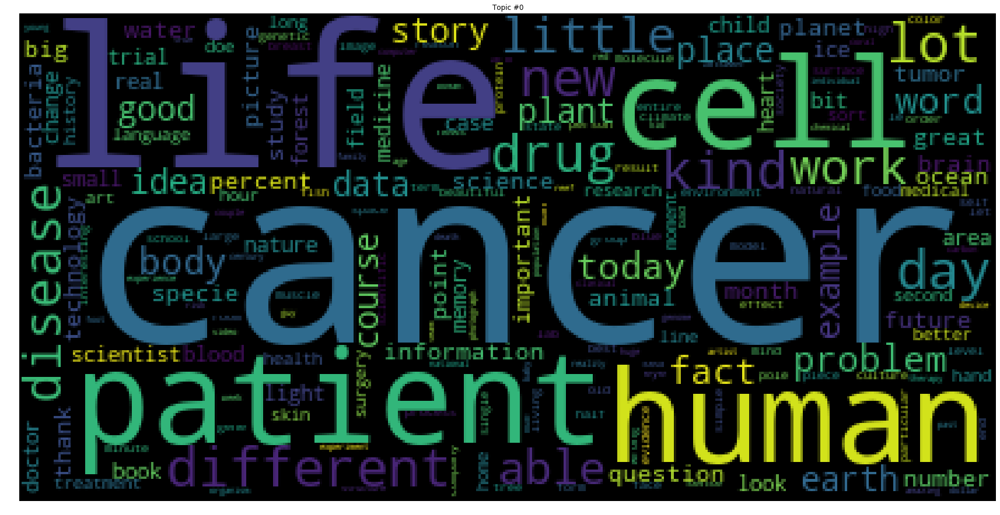

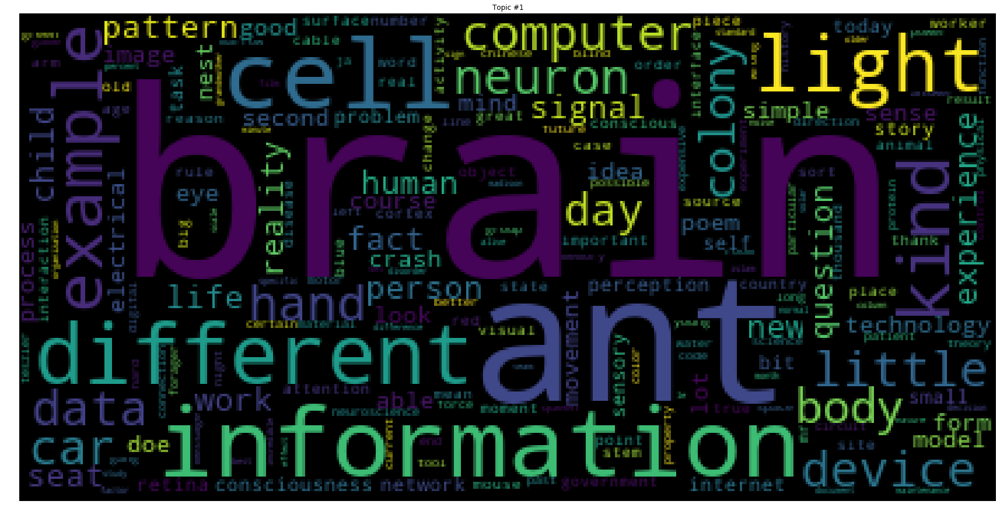

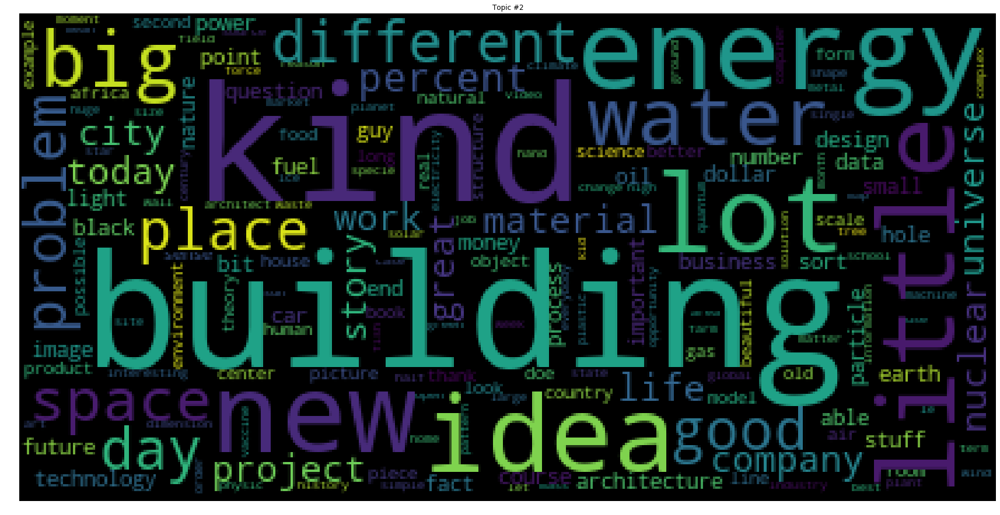

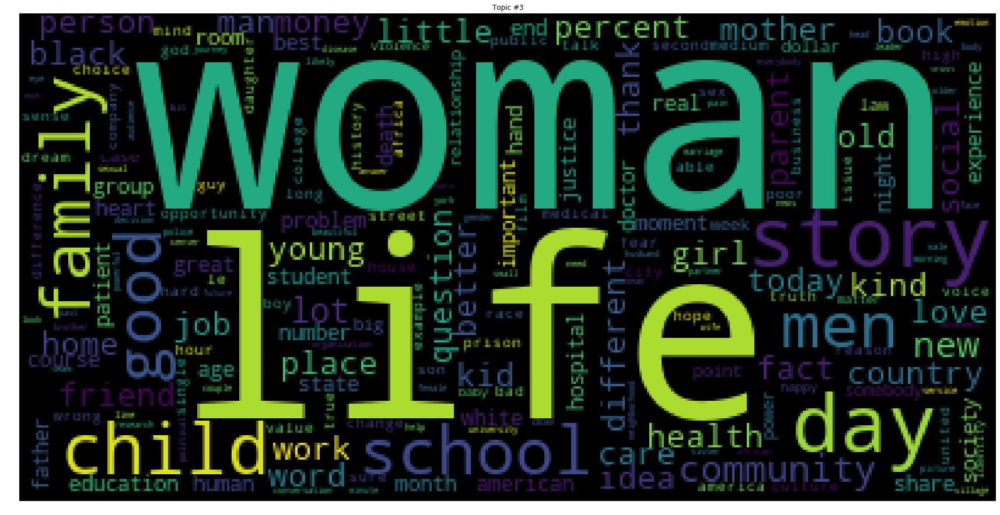

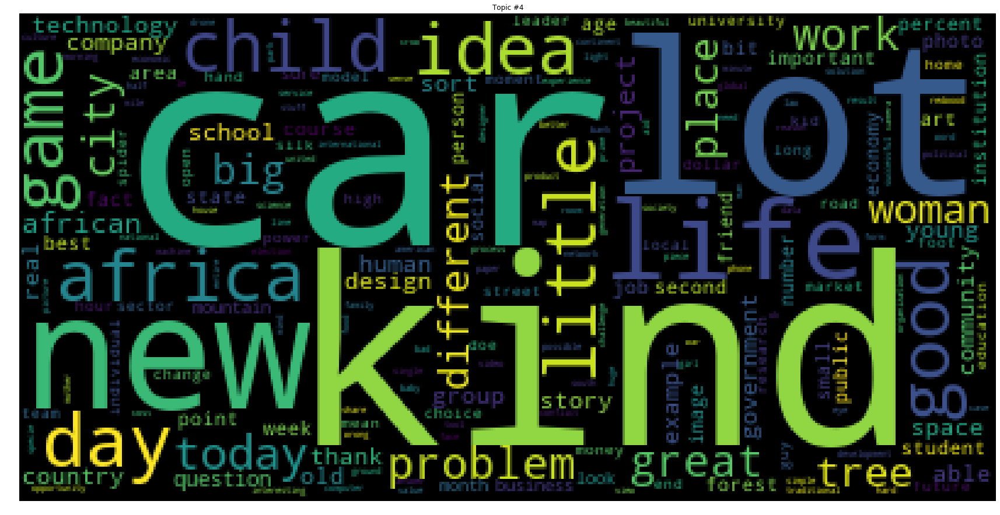

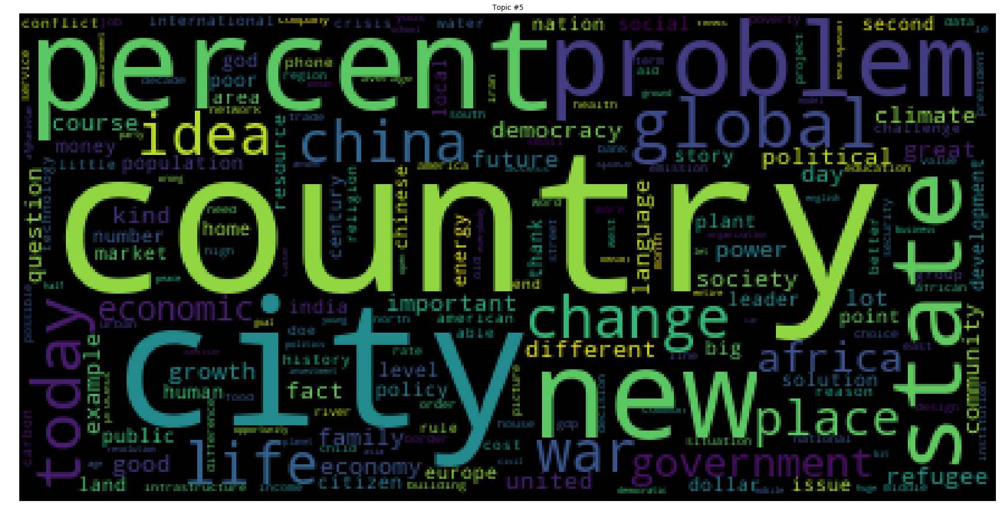

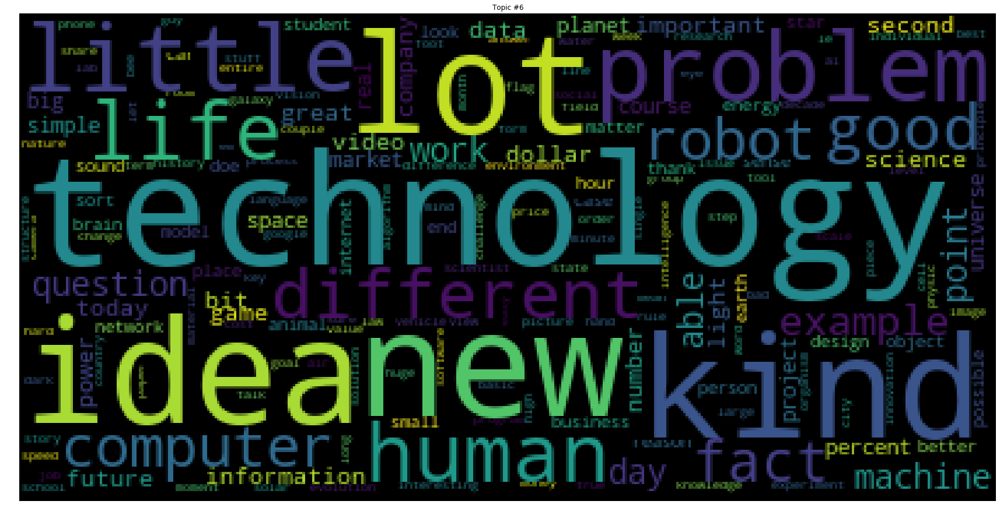

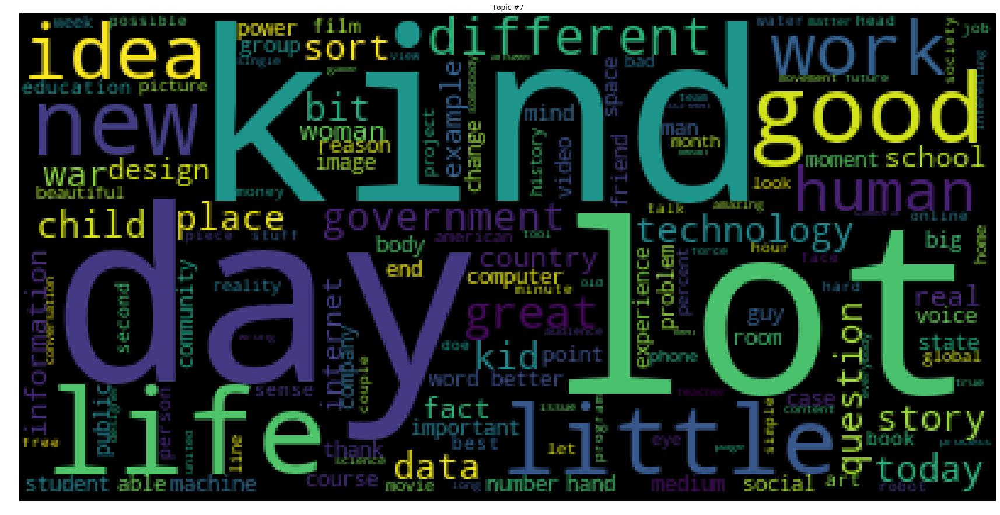

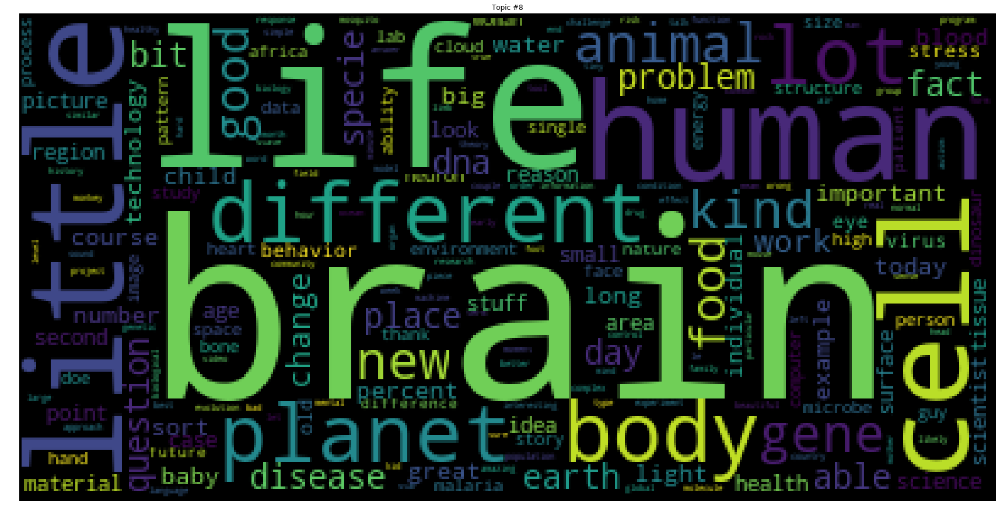

In [208]:
# from Hamilton's slack (LDA visuals)
ldamodel = ldana
# Reset the output dimensions
plt.rcParams['figure.figsize'] = [30, 30]

for t in range(ldamodel.num_topics):
    plt.figure()
    plt.imshow(WordCloud().fit_words(dict(ldamodel.show_topic(t, 200))))
    plt.axis("off")
    plt.title("Topic #" + str(t))
    plt.show()

#### Identify Topics in Each Document

In [ ]:
# Our final LDA model (for now)
ldana = models.LdaModel(corpus=corpusna, num_topics=4, id2word=id2wordna, passes=80)
ldana.print_topics()

In [ ]:
# Let's take a look at which topics each transcript contains
corpus_transformed = ldana[corpusna]
list(zip([a for [(a,b)] in corpus_transformed], data_dtmna.index))

In [52]:

wc = WordCloud(stopwords=stop_words, background_color="white", colormap="Dark2",
               max_font_size=150, random_state=42)

In [68]:
data_clean.head(20)

,index,text
0,0,thank you so much chris and it is truly a great honor to have the opportunity to come to this stage twice I am extremely grateful i have been blown away by this conference and i want to thank all of you for the many nice comments about what i had to say the other night and i say that sincerely partly because i need that put yourselves in my position i flew on air force two for eight years now i have to take off my shoes or boots to get on an airplane I will tell you one quick story to illustrate what that is been like for me it is a true story every bit of this is true soon after tipper and i left the white house we were driving from our home in nashville to a little farm we have miles east of nashville driving ourselves i...
1,9,if you are here today and I am very happy that you are you have all heard about how sustainable development will save us from ourselves however when we are not at ted we are often told that a real sustainability policy agenda is just not feasible especially in large urban areas like new york city and that is because most people with decisionmaking powers in both the public and the private sector really do not feel as though they are in danger the reason why I am here today in part is because of a dog an abandoned puppy i found back in the rain back in she turned out to be a much bigger dog than I would anticipated when she came into my life we were fighting against a huge waste facility planned for the east river waterfront despite the fact that our small part of new york city...
2,18,good morning how are you it is been great has not it I have been blown away by the whole thing in fact I am leaving there have been three themes running through the conference which are relevant to what i want to talk about one is the extraordinary evidence of human creativity in all of the presentations that we have had and in all of the people here just the variety of it and the range of it the second is that it is put us in a place where we have no idea what is going to happen in terms of the future no idea how this may play out i have an interest in education actually what i find is everybody has an interest in education do not you i find this very interesting if you are at a dinner party and you say you work in education actually you are not often at dinner par...
3,25,about years ago i took on the task to teach global development to swedish undergraduate students that was after having spent about years together with african institutions studying hunger in africa so i was sort of expected to know a little about the world and i started in our medical university karolinska institute an undergraduate course called global health but when you get that opportunity you get a little nervous i thought these students coming to us actually have the highest grade you can get in swedish college systems so i thought maybe they know everything I am going to teach them about so i did a pretest when they came and one of the questions from which i learned a lot was this one which country has the highest child mortality of these five pairs i put them together s...
4,36,thank you i have to tell you I am both challenged and excited my excitement is i get a chance to give something back my challenge is the shortest seminar i usually do is hours I am not exaggerating i do weekends i do more obviously i also coach people but I am into immersion because how did you learn language not just by learning principles you got in it and you did it so often that it became real the bottom line of why I am here besides being a crazy mofo is that I am not here to motivate you you do not need that obviously often that is what people think i do and it is the furthest thing from it what happens though is people say to me i do not need any motivation but that is not what i do I am the why guy i want to know why you do what you do what is your motive for...
5,44,I am going to present three projects in rapid fire i do not have much time to do

In [67]:
data_clean.reset_index(inplace=True)

Int64Index([    0,     9,    18,    25,    36,    44,    49,    57,    65,
               75,
            ...
            12031, 12039, 12044, 12052, 12058, 12066, 12073, 12083, 12092,
            12100],
           dtype='int64', length=1591)

In [66]:
data_clean.columns

Index(['text'], dtype='object')

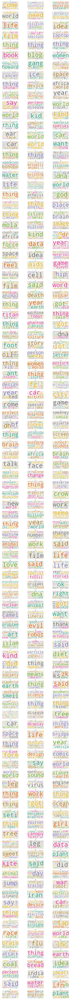

In [69]:
# Reset the output dimensions
plt.rcParams['figure.figsize'] = [21, 300]

# Create subplots for 300 speeches
for speech_num in list(range(0,300)):
    wc.generate(data_clean.text[speech_num])
    
    plt.subplot(100, 3, speech_num+1)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(speech_num)
    
plt.show()

In [62]:
data_clean.text[113]

'            '

In [67]:
pd.set_option('max_colwidth',800)
data_clean.iloc[111:114]

,text
111,i am known best for humanpowered flight but that was just one thing that got me going in the sort of things that im working in now as a youngster i was very interested in model airplanes ornithopters autogyros helicopters gliders power planes indoor models outdoor models everything which i just thought was a lot of fun and wondered why most other people didnt share my same enthusiasm with them and then navy pilot training and after college i got into sailplane flying power plane flying and considered the sailplanes as a sort of hobby and fun but got tangled up with some great professor types who convinced me and everybody else in the field that this was a good way to get into really deep science while this was all going on i was in the field of weather modification although gettin...
112,in the next minutes im going to take you on a journey and its a journey that you and i have been on for many years now and it began some years ago when humans first stepped off our planet and in those years not only did we literally physically set foot on the moon but we have dispatched robotic spacecraft to all the planets all eight of them and we have landed on asteroids we have rendezvoused with comets and at this point in time we have a spacecraft on its way to pluto the body formerly known as a planet and all of these robotic missions are part of a bigger human journey a voyage to understand something to get a sense of our cosmic place to understand something of our origins and how earth our planet and we living on it came to be and of all the places in the solar system ...
113,


In [76]:
pd.reset_option('max_colwidth')
df.iloc[112:115]

,Talk_ID,public_url,headline,description,event,duration,published,tags,views,text,...,speaker2_introduction,speaker2_profile,speaker_3,speaker3_occupation,speaker3_introduction,speaker3_profile,speaker_4,speaker4_occupation,speaker4_introduction,speaker4_profile
112,178,https://www.ted.com/talks/carolyn_porco_flies_...,This is Saturn,Planetary scientist Carolyn Porco shows images...,TED2007,0:17:09,10/1/07,"Planets,solar system,NASA,visualizations,explo...",2711956,"In the next 18 minutes, I'm going to take yo...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
113,179,https://www.ted.com/talks/kenichi_ebina_s_magi...,My magic moves,Kenichi Ebina moves his body in a manner that ...,TED2007,0:03:32,10/3/07,"entertainment,culture,dance,performance",1763082,(Applause) (Music) (Applause),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
114,181,https://www.ted.com/talks/richard_branson_s_li...,"Life at 30,000 feet",Richard Branson talks to TED's Chris Anderson ...,TED2007,0:29:51,10/9/07,"entertainment,interview,global issues,aircraft...",1659113,Chris Anderson: Welcome to TED. Richard B...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [77]:
df.text.iloc[113]

'  (Applause)    (Music)    (Applause)  '

In [105]:
df.iloc[50:60]

,Talk_ID,public_url,headline,description,event,duration,published,views,text,speaker_1,...,speaker2_profile,speaker_3,speaker3_occupation,speaker3_introduction,speaker3_profile,speaker_4,speaker4_occupation,speaker4_introduction,speaker4_profile,tag
50,96,https://www.ted.com/talks/tony_robbins_asks_wh...,Why we do what we do,"Tony Robbins discusses the ""invisible forces"" ...",TED2006,0:21:45,6/27/06,22368699,Thank you. I have to tell you I'm both chall...,Tony Robbins,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,emotions
51,96,https://www.ted.com/talks/tony_robbins_asks_wh...,Why we do what we do,"Tony Robbins discusses the ""invisible forces"" ...",TED2006,0:21:45,6/27/06,22368699,Thank you. I have to tell you I'm both chall...,Tony Robbins,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,culture
52,96,https://www.ted.com/talks/tony_robbins_asks_wh...,Why we do what we do,"Tony Robbins discusses the ""invisible forces"" ...",TED2006,0:21:45,6/27/06,22368699,Thank you. I have to tell you I'm both chall...,Tony Robbins,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,business
53,49,https://www.ted.com/talks/joshua_prince_ramus_...,Behind the design of Seattle's library,Architect Joshua Prince-Ramus takes the audien...,TED2006,0:19:58,7/10/06,1042335,I'm going to present three projects in rapid...,Joshua Prince-Ramus,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,library
54,49,https://www.ted.com/talks/joshua_prince_ramus_...,Behind the design of Seattle's library,Architect Joshua Prince-Ramus takes the audien...,TED2006,0:19:58,7/10/06,1042335,I'm going to present three projects in rapid...,Joshua Prince-Ramus,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,architecture
55,49,https://www.ted.com/talks/joshua_prince_ramus_...,Behind the design of Seattle's library,Architect Joshua Prince-Ramus takes the audien...,TED2006,0:19:58,7/10/06,1042335,I'm going to present three projects in rapid...,Joshua Prince-Ramus,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,design
56,49,https://www.ted.com/talks/joshua_prince_ramus_...,Behind the design of Seattle's library,Architect Joshua Prince-Ramus takes the audien...,TED2006,0:19:58,7/10/06,1042335,I'm going to present three projects in rapid...,Joshua Prince-Ramus,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,culture
57,49,https://www.ted.com/talks/joshua_prince_ramus_...,Behind the design of Seattle's library,Architect Joshua Prince-Ramus takes the audien...,TED2006,0:19:58,7/10/06,1042335,I'm going to present three projects in rapid...,Joshua Prince-Ramus,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,collaboration
58,86,https://www.ted.com/talks/julia_sweeney_on_let...,Letting go of God,When two young Mormon missionaries knock on Ju...,TED2006,0:16:32,7/10/06,3903747,"On September 10, the morning of my seventh b...",Julia Sweeney,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,atheism
59,86,https://www.ted.com/talks/julia_sweeney_on_let...,Letting go of God,When two young Mormon missionaries knock on Ju...,TED2006,0:16:32,7/10/06,3903747,"On September 10, the morning of my seventh b...",Julia Sweeney,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Christianity
